# Chemical Process Anomaly Detection Baseline 🕵️
### 화학 공정 데이터를 분석하고 🧐, 이상 탐지 Baseline Model 을 학습합니다 📖.


## Table of Contents
1. 필요 Library Import
2. Load Data
3. EDA
4. Data Process
5. Model Training
6. Model Inference


### 1. 필요 Library Import

- 필요 Library 설치를 위해 아래 명령어를 실행 합니다.
- (실행 초기에 한 번만 실행하면 됩니다!)

In [1]:
! pip install -r requirements.txt

- 노트북에서 사용하는 필요 Library 를 import 합니다

In [1]:
from typing import Union
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
from pathlib import Path
from sklearn.ensemble import IsolationForest
from sklearn.linear_model import SGDOneClassSVM

- 모델 학습에 필요한 `random_seed` 를 설정하고, `DATA_PATH` 를 설정합니다.
- 해당 `DATA_PATH` 에는 `train.csv`, `test.csv` 파일이 있다고 가정합니다.

In [2]:
RANDOM_SEED = 42
DATA_PATH = Path("../data")

np.random.seed(RANDOM_SEED)
random.seed(RANDOM_SEED)


### 2. Load Train Data


In [3]:
pwd

'/data/ephemeral/home/AD/code'

In [4]:
train_data = pd.read_csv(DATA_PATH / "train.csv")

### 3. EDA

### 3.1 데이터 유형 확인

- 학습 데이터는 총 2500000 개의 row 와 55개의 column을 갖고 있습니다.

In [5]:
train_data.shape

(250000, 55)

각 column의 의미는 다음과 같습니다.
- `faultNumber` : 정상인지, 비정상인지 나타내는 Label 입니다. 정상일 경우 `0`, 비정상일 경우 `1` 입니다. 
- `simulationRun` : 시뮬레이션이 실행된 Run 의 번호 입니다. 
  - 동일한 하나의 `simulationRun` 이 정상일 경우 `faultNumber` 가 모두 `0` 입니다.
  - 반대로 하나의 `simulationRun` 이 비정상일 경우 `faultNumber` 가 모두 `1` 입니다.
  - 학습 데이터에는 정상 데이터만 존재합니다. 따라서 `faultNumber` 가 모두 `0` 입니다.
  - 테스트 데이터에는 정상/비정상 데이터가 모두 존재합니다. 따라서 `faultNumber` 가 모두 `0`인 `simulationRun` 도 있고, `faultNumber` 모두 `1`인 `simulationRun` 도 있습니다.
- `sample` : 하나의 Run 안의 sample 번호를 의미합니다. 학습 데이터는 한 Run 당 500 sample 이 있습니다.
- `xmeas_*` : measurement 의 약자로, 화학 공정에서 측정된 센서 값 입니다.
- `xmv_*` : manipulated variable 의 약자로, 화학 공정에서 제어되는 값 입니다.
    - measurement 와 manipulated 관련 설명은 [다음 자료](https://chemicalada.blogspot.com/2016/02/classification-of-variables-in-chemical.html)를 참고하시기 바랍니다.
    

In [6]:
train_data.describe()

,faultNumber,simulationRun,sample,xmeas_1,xmeas_2,xmeas_3,xmeas_4,xmeas_5,xmeas_6,xmeas_7,...,xmv_2,xmv_3,xmv_4,xmv_5,xmv_6,xmv_7,xmv_8,xmv_9,xmv_10,xmv_11
count,250000.0,250000.000000,250000.000000,250000.000000,250000.000000,250000.00000,250000.000000,250000.000000,250000.000000,250000.000000,...,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000,250000.000000
mean,0.0,250.500000,250.500000,0.250482,3663.785706,4508.81979,9.347101,26.902196,42.337598,2705.037865,...,53.973668,24.639472,61.298501,22.216644,40.055456,38.098898,46.534295,47.958591,41.104304,18.118706
std,0.0,144.337567,144.337567,0.030873,34.006357,39.21542,0.085721,0.211485,0.218513,7.525596,...,0.469663,3.037743,1.243805,0.530156,1.526751,2.965266,2.351304,2.716520,0.540817,1.463678
min,0.0,1.000000,1.000000,0.122450,3511.800000,4336.90000,8.972700,25.951000,41.394000,2672.300000,...,52.095000,11.977000,55.961000,19.749000,33.389000,25.959000,36.937000,36.641000,38.586000,11.705000
25%,0.0,125.750000,125.750000,0.229770,3640.800000,4482.40000,9.289300,26.758000,42.188000,2700.100000,...,53.657000,22.602000,60.453000,21.864000,39.021000,36.081000,44.931000,46.265000,40.740000,17.130000
50%,0.0,250.500000,250.500000,0.250510,3663.700000,4508.80000,9.347100,26.902000,42.338000,2705.000000,...,53.974000,24.644000,61.298000,22.217000,40.058000,38.091000,46.530000,47.820000,41.104000,18.119000
75%,0.0,375.250000,375.250000,0.271200,3686.800000,4535.30000,9.405100,27.046000,42.487000,2710.000000,...,54.290000,26.674000,62.144000,22.568000,41.084000,40.117000,48.140000,49.651000,41.470000,19.111000
max,0.0,500.000000,500.000000,0.391740,3808.400000,4683.70000,9.729800,27.818000,43.257000,2739.100000,...,56.118000,38.351000,66.443000,24.525000,47.498000,50.729000,56.443000,59.616000,43.930000,24.762000


학습 데이터에 대해 Histogram 을 그려보면, 다음을 알 수 있습니다.
  - `faultNumber` 값은 `0` 인 정상 데이터 만 존재합니다.
  - `simulationRun`, `sample` 값은 `0` ~ `500` 까지 일정하게 빈도수가 분포되어 있습니다.
  - `xmeas_*`, `xmv_*` 값의 범위는 다 다르고, 정규 분포와 비슷하게 데이터가 분포되어있습니다.

train_data.hist(figsize=(20, 15))
plt.tight_layout()
plt.show()

### 3.2 데이터 시각화

아래에는 데이터를 시각화를 위해 `plotly` 라는 패키지를 사용합니다.
기본적으로 `requirements.txt` 에 포함되어 있으나, 설치하지 않은 분들은 아래 명령어를 실행해주시기 바랍니다.

In [8]:
! pip install plotly

### 3.2 Plot Correlation matrix

- 센서 값(`xmeas`, `xmv`) 들의 변수간 상관 관계를 이해하기 위해, Corrleation Matrix 를 시각화 합니다.
- Correlation 의 값이 0(초록색)에 가까울 수록, 변수간 상관 관계가 적다는 것을 뜻합니다.
- 반대로, Correlation 의 값이 1(노란색) 또는 -1(남색) 에 가까울 수록, 양 또는 음의 상관 관계가 강하게 나타남을 의미합니다.
- 일부 변수들 끼리 양, 음의 상관 관계가 강하게 나타남을 알 수 있습니다.

In [7]:
import pandas as pd
import plotly.graph_objects as go

# 학습 데이터의 상관관계를 계산합니다.
correlation_matrix = train_data.corr()


### 3.3 Plot pairs with high/low correlations
- correlation matrix 값 중, 상관 관계 절대 값이 높은 조합의 변수들을 찾아 구체적으로 시각화해보겠습니다.
- 이 때, correlation matrix 의 다음 항목들은 제외합니다.
  - upper triangle 값과 lower triangle 값은 동일하므로, lower triangle 은 제외합니다.
  - 자기 자신과의 상관관계는 1이므로, diagonal 영역의 값은 제외합니다.

In [8]:
# correlation matrix 의 diagonal 을 제외한 upper triangle 값을 추출합니다.
upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))

# (NxN) -> (N^2 X 1) 로 변환(stack) 후, pandas dataframe 을 만듭니다. 
correlation_df = upper_triangle.stack().reset_index().rename(columns={0: "correlation_value"})

- 내림 차순으로 상관관계를 정렬하여 양의 상관 관계가 높은 변수 쌍은 다음과 같습니다.

In [9]:
top_5_correlations = correlation_df.sort_values(by="correlation_value", ascending=False)[:5]
print(top_5_correlations)

      level_0   level_1  correlation_value
646  xmeas_12     xmv_7           1.000000
761  xmeas_15     xmv_8           1.000000
401   xmeas_7  xmeas_13           0.997386
147   xmeas_1     xmv_3           0.996587
900  xmeas_19     xmv_9           0.986063


- 오름 차순으로 상관관계를 정렬하여 음의 상관 관계가 높은 변수 쌍은 다음과 같습니다.

In [10]:
bottom_5_correlations = correlation_df.sort_values(by="correlation_value")[:5]
print(bottom_5_correlations)

      level_0   level_1  correlation_value
835  xmeas_17    xmv_11          -0.999243
920  xmeas_20  xmeas_38          -0.581375
399   xmeas_7  xmeas_11          -0.576832
571  xmeas_11  xmeas_13          -0.565694
670  xmeas_13  xmeas_33          -0.565231


### 4. Data Process

- `simulationRun` 과 `sample` 변수는 큰 정보량을 담고 있지 않기 때문에, 공정의 센서 값을 반영하는 변수들을 선택합니다.
- 따라서, `process_data` 함수에서는 `xmeas`, `xmv` 와 같은 숫자형 변수들을(numerical value) 초도 모델 학습에 사용합니다.
- 정규화와 feature engineering의 과정은 포함되지 않았으므로, `process_data` 함수 전, 후로 더 다양한 전처리 과정을 추가해보시길 권장합니다.

In [11]:
def process_data(df) -> pd.DataFrame:
    numeric_cols = [
        'xmeas_1', 'xmeas_10', 'xmeas_11', 'xmeas_12', 'xmeas_13', 'xmeas_14',
        'xmeas_15', 'xmeas_16', 'xmeas_17', 'xmeas_18', 'xmeas_19', 'xmeas_2',
        'xmeas_20', 'xmeas_21', 'xmeas_22', 'xmeas_23', 'xmeas_24', 'xmeas_25',
        'xmeas_26', 'xmeas_27', 'xmeas_28', 'xmeas_29', 'xmeas_3', 'xmeas_30',
        'xmeas_31', 'xmeas_32', 'xmeas_33', 'xmeas_34', 'xmeas_35', 'xmeas_36',
        'xmeas_37', 'xmeas_38', 'xmeas_39', 'xmeas_4', 'xmeas_40', 'xmeas_41',
        'xmeas_5', 'xmeas_6', 'xmeas_7', 'xmeas_8', 'xmeas_9', 'xmv_1',
        'xmv_10', 'xmv_11', 'xmv_2', 'xmv_3', 'xmv_4', 'xmv_5', 'xmv_6',
        'xmv_7', 'xmv_8', 'xmv_9'
    ]
    return df[numeric_cols]

In [12]:
train_X = process_data(train_data)

### 5. Model Training

### 5.1 DROCC

In [13]:
import os
import numpy as np
import argparse
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from collections import OrderedDict
#from data_process_scripts.process_cifar import CIFAR10_Dataset
#from edgeml_pytorch.trainer.drocc_trainer import DROCCTrainer

In [14]:
# 시드를 고정합니다.
SEED = RANDOM_SEED
os.environ['PYTHONHASHSEED'] = str(SEED)
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.benchmark = True

In [15]:
lamda = 1  
radius = 8 
lr = 0.001 
gamma = 1 
ascent_step_size = 0.001 
batch_size =  256 
epochs = 20 
optim = 0
normal_class = 0
hd = 128

In [16]:
class LSTM_FC(nn.Module):
    """
    Single layer LSTM with a fully connected layer
    on the last hidden state
    """
    def __init__(self,
                 input_dim=32,
                 num_classes=1, 
                 num_hidden_nodes=8
    ):

        super(LSTM_FC, self).__init__()
        self.input_dim = input_dim
        self.num_classes = num_classes
        self.num_hidden_nodes = num_hidden_nodes
        self.encoder = nn.LSTM(input_size=self.input_dim, 
            hidden_size=self.num_hidden_nodes,
            num_layers=1, batch_first=True)
        self.fc = nn.Linear(self.num_hidden_nodes,
            self.num_classes)
        activ = nn.ReLU(True)
        

    def forward(self, input):
        features = self.encoder(input)[0][:,-1,:]
        # pdb.set_trace()
        logits = self.fc(features)
        return logits

In [23]:
import os
import copy
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from sklearn.metrics import roc_auc_score, precision_recall_fscore_support
from tqdm.auto import tqdm, trange

#trainer class for DROCC
class DROCCTrainer:
    """
    Trainer class that implements the DROCC algorithm proposed in
    https://arxiv.org/abs/2002.12718
    """

    def __init__(self, model, optimizer, lamda, radius, gamma, device):
        self.model = model
        self.optimizer = optimizer
        self.lamda = lamda
        self.radius = radius
        self.gamma = gamma
        self.device = device

    def train(self, train_loader, val_loader, learning_rate, total_epochs, 
                only_ce_epochs=50, ascent_step_size=0.001, ascent_num_steps=50,
                metric='F1'):

        best_score = -np.inf
        best_model = None
        self.ascent_num_steps = ascent_num_steps
        self.ascent_step_size = ascent_step_size
        df1 = pd.DataFrame()
        for epoch in tqdm(range(total_epochs), desc='1st loop', leave=True): #trange(total_epochs, desc='1st loop', leave=True): # , desc='2nd loop', leave=False
            #Make the weights trainable
            
            self.model.train()
            #lr_scheduler(epoch, total_epochs, only_ce_epochs, learning_rate, self.optimizer)
            
            #Placeholder for the respective 2 loss values
            epoch_adv_loss = torch.tensor([0]).type(torch.float32).to(self.device)  #AdvLoss
            epoch_ce_loss = 0  #Cross entropy Loss
            
            batch_idx = -1
            for data, target, _ in train_loader:
                batch_idx += 1
                data, target = data.to(self.device), target.to(self.device)
                # Data Processing
                data = data.to(torch.float)
                target = target.to(torch.float)
                target = torch.squeeze(target)
                #print(target[:5])
                self.optimizer.zero_grad()
                
                # Extract the logits for cross entropy loss
                logits = self.model(data)
                print(logits:5)
                logits = torch.squeeze(logits, dim = 1)
                print(logits:5)
                ce_loss = F.binary_cross_entropy_with_logits(logits, target)

                # f1-score loss 반영
                #target = target.cpu().data.numpy().tolist()
                #logits = logits.cpu().data.numpy().tolist()
                #thresh = np.percentile(logits, 20)
                #y_pred = np.where(logits >= thresh, 1, 0)
                #_prec, _recall, f1_loss, _ = precision_recall_fscore_support(target, y_pred, average="binary")
                ## Add to the epoch variable for printing average CE Loss
                
                #f1_loss = 1 - torch.from_numpy(np.array(f1_loss)).to(self.device)
                epoch_ce_loss += ce_loss #+ f1_loss
                
                loss = ce_loss # + f1_loss
                
                # Backprop
                loss.backward()
                self.optimizer.step()
        
                    
            epoch_ce_loss = epoch_ce_loss/(batch_idx + 1)  #Average CE Loss
            epoch_adv_loss = epoch_adv_loss/(batch_idx + 1) #Average AdvLoss

            test_score = self.test(val_loader, metric)
            if test_score > best_score:
                best_score = test_score
                best_model = copy.deepcopy(self.model)
            print('Epoch: {}, CE Loss: {}, AdvLoss: {}, F1-socre:{}'.format(
                epoch, epoch_ce_loss.item(), epoch_adv_loss.item(), test_score)) # test_score
            df2 = pd.DataFrame.from_records([{'Epoch' : epoch, 'CE Loss' : epoch_ce_loss.item(), 
                          'AdvLoss' : epoch_adv_loss.item(), 'loss' : loss.tolist(), 
                          'F1-socre':test_score}]) 
            df1 = pd.concat([df1, df2])

        # DataFrame을 CSV로 내보내기
        df1.to_csv('result_file.csv', index=False)


    def test(self, test_loader, metric='F1'):
        """Evaluate the model on the given test dataset.

        Parameters
        ----------
        test_loader: Dataloader object for the test dataset.
        metric: Metric used for evaluation (AUC / F1).
        """        
        self.model.eval()
        label_score = []
        batch_idx = -1
        for data, target, _ in test_loader:
            batch_idx += 1
            data, target = data.to(self.device), target.to(self.device)
            data = data.to(torch.float)
            target = target.to(torch.float)
            target = torch.squeeze(target)

            logits = self.model(data)
            logits = torch.squeeze(logits, dim = 1)
            sigmoid_logits = torch.sigmoid(logits)
            scores = logits
            label_score += list(zip(target.cpu().data.numpy().tolist(),
                                            scores.cpu().data.numpy().tolist()))
        # Compute test score
        labels, scores = zip(*label_score)
        labels = np.array(labels)
        scores = np.array(scores)
        print(np.mean(scores), scores[:5])
        if metric == 'F1':
            
            thresh = np.percentile(scores, 20)
            y_pred = np.where(scores >= thresh, 1, 0)
            prec, recall, test_metric, _ = precision_recall_fscore_support(
                labels, y_pred, average="binary")
        if metric == 'AUC':
            test_metric = roc_auc_score(labels, scores)
        return test_metric
    

    def val(self, val_loader, metric='F1'):
        """Evaluate the model on the given test dataset.

        Parameters
        ----------
        test_loader: Dataloader object for the test dataset.
        metric: Metric used for evaluation (AUC / F1).
        """        
        self.model.eval()
        label_score = []
        batch_idx = -1
        for data in val_loader:
            batch_idx += 1
            data = data.to(self.device)
            data = data.to(torch.float)
            
            logits = self.model(data)
            logits = torch.squeeze(logits, dim = 1)
            #sigmoid_logits = torch.sigmoid(logits)
            scores = logits
            label_score += list(scores.cpu().data.numpy().tolist())
        # Compute test score
        scores = np.array(label_score)
        
        return scores
        

SyntaxError: invalid syntax (3911877744.py, line 58)

In [24]:
import torchvision.transforms as transforms
from torch.utils.data import DataLoader

class CustomDataset(Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        return torch.from_numpy(self.data[idx]), (self.labels[idx]), torch.tensor([0])
    
class Test_for_CustomDataset(Dataset):
    def __init__(self, data):
        self.data = data
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        return torch.from_numpy(self.data[idx])

    
def load_data(train_data, test_data, val_data):
    ##preprocessing 
    mean=np.mean(train_data,0)
    std=np.std(train_data,0)
    train_data=(train_data-mean)/std
    test_data = (test_data - mean)/std
    val_data = (val_data - mean)/std
    train_lab = np.ones((train_data.shape[0])) #All positive labelled data points collected
    test_lab = np.ones((test_data.shape[0]))
    
    train_samples = train_data.shape[0]
    test_samples = test_data.shape[0]
    val_samples = val_data.shape[0]
    print("Train Samples: ", train_samples)
    print("Test Samples: ", test_samples)
    print("Val Samples: ", val_samples)
    train_data = np.expand_dims(train_data, axis =2)
    test_data = np.expand_dims(test_data, axis =2)
    val_data = np.expand_dims(val_data, axis =2)
    return CustomDataset(train_data, train_lab), CustomDataset(test_data, test_lab), Test_for_CustomDataset(val_data)
    
val_data = pd.read_csv(DATA_PATH / "test.csv")
val_data_X = process_data(val_data)
print(train_X.shape)
print(val_data_X.shape)

train_dataset, test_dataset, val_dataset = load_data(train_X[:200000], train_X[200000:], val_data_X) 
train_loader = DataLoader(train_dataset, batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size, shuffle=False)



(250000, 52)
(710400, 52)
Train Samples:  200000
Test Samples:  50000
Val Samples:  710400


In [25]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
print(device)

model = LSTM_FC(input_dim=1, num_classes=1, num_hidden_nodes=hd).to(device)
#model = nn.DataParallel(model)

if optim == 1:
    optimizer = optim.SGD(model.parameters(),lr=lr)           
    print("using SGD")
else:
    optimizer = optim.Adam(model.parameters(),lr=lr)
    print("using Adam")

trainer = DROCCTrainer(model, optimizer, lamda, radius, gamma, device)
trainer.train(train_loader, test_loader, learning_rate=lr, total_epochs=epochs)

cuda
using Adam


1st loop:   0%|          | 0/20 [00:00<?, ?it/s]

tensor([[0.0052],
        [0.0039],
        [0.0043],
        [0.0041],
        [0.0040],
        [0.0052],
        [0.0036],
        [0.0062],
        [0.0058],
        [0.0058],
        [0.0045],
        [0.0040],
        [0.0047],
        [0.0049],
        [0.0045],
        [0.0042],
        [0.0063],
        [0.0047],
        [0.0054],
        [0.0045],
        [0.0064],
        [0.0055],
        [0.0045],
        [0.0040],
        [0.0065],
        [0.0079],
        [0.0039],
        [0.0045],
        [0.0041],
        [0.0062],
        [0.0075],
        [0.0044],
        [0.0049],
        [0.0046],
        [0.0044],
        [0.0045],
        [0.0056],
        [0.0050],
        [0.0059],
        [0.0052],
        [0.0071],
        [0.0037],
        [0.0045],
        [0.0052],
        [0.0042],
        [0.0039],
        [0.0045],
        [0.0044],
        [0.0044],
        [0.0041],
        [0.0041],
        [0.0042],
        [0.0050],
        [0.0042],
        [0.0039],
        [0

1st loop:   5%|▌         | 1/20 [00:11<03:46, 11.94s/it]

10.11518671049118 [10.11601448 10.11457062 10.11558628 10.11346912 10.11565018]
Epoch: 0, CE Loss: 0.011841978877782822, AdvLoss: 0.0, F1-socre:0.888888888888889
tensor([[10.1158],
        [10.1146],
        [10.1138],
        [10.1155],
        [10.1117],
        [10.1157],
        [10.1153],
        [10.1125],
        [10.1156],
        [10.1157],
        [10.1157],
        [10.1153],
        [10.1154],
        [10.1151],
        [10.1159],
        [10.1131],
        [10.1157],
        [10.1158],
        [10.1154],
        [10.1156],
        [10.1141],
        [10.1149],
        [10.1152],
        [10.1160],
        [10.1142],
        [10.1156],
        [10.1157],
        [10.1151],
        [10.1152],
        [10.1141],
        [10.1152],
        [10.1157],
        [10.1157],
        [10.1148],
        [10.1156],
        [10.1161],
        [10.1157],
        [10.1143],
        [10.1160],
        [10.1157],
        [10.1153],
        [10.1150],
        [10.1147],
        [10.1160],
  

1st loop:  10%|█         | 2/20 [00:24<03:36, 12.03s/it]

11.227298410930633 [11.22491455 11.22668743 11.22676563 11.22716522 11.22446156]
Epoch: 1, CE Loss: 2.3246782802743837e-05, AdvLoss: 0.0, F1-socre:0.8890370172865839
tensor([[11.2260],
        [11.2270],
        [11.2269],
        [11.2269],
        [11.2252],
        [11.2279],
        [11.2268],
        [11.2267],
        [11.2267],
        [11.2280],
        [11.2279],
        [11.2270],
        [11.2275],
        [11.2277],
        [11.2277],
        [11.2264],
        [11.2274],
        [11.2259],
        [11.2278],
        [11.2278],
        [11.2267],
        [11.2272],
        [11.2277],
        [11.2273],
        [11.2278],
        [11.2277],
        [11.2271],
        [11.2241],
        [11.2271],
        [11.2257],
        [11.2272],
        [11.2268],
        [11.2272],
        [11.2277],
        [11.2275],
        [11.2262],
        [11.2265],
        [11.2266],
        [11.2280],
        [11.2276],
        [11.2243],
        [11.2271],
        [11.2276],
        [11.2273]

1st loop:  15%|█▌        | 3/20 [00:35<03:22, 11.93s/it]

11.995844790267943 [11.9960556  11.99567795 11.99614716 11.99441242 11.99701691]
Epoch: 2, CE Loss: 9.191201570502017e-06, AdvLoss: 0.0, F1-socre:0.8889506138547859
tensor([[11.9956],
        [11.9953],
        [11.9972],
        [11.9958],
        [11.9958],
        [11.9960],
        [11.9959],
        [11.9968],
        [11.9945],
        [11.9961],
        [11.9959],
        [11.9967],
        [11.9967],
        [11.9967],
        [11.9963],
        [11.9963],
        [11.9953],
        [11.9944],
        [11.9965],
        [11.9959],
        [11.9965],
        [11.9964],
        [11.9959],
        [11.9963],
        [11.9942],
        [11.9966],
        [11.9961],
        [11.9955],
        [11.9959],
        [11.9962],
        [11.9967],
        [11.9970],
        [11.9967],
        [11.9955],
        [11.9957],
        [11.9968],
        [11.9959],
        [11.9964],
        [11.9965],
        [11.9943],
        [11.9961],
        [11.9962],
        [11.9951],
        [11.9963],

1st loop:  15%|█▌        | 3/20 [00:45<04:18, 15.22s/it]

tensor([[12.5240],
        [12.5240],
        [12.5233],
        [12.5240],
        [12.5240],
        [12.5216],
        [12.5240],
        [12.5233],
        [12.5239],
        [12.5237],
        [12.5238],
        [12.5238],
        [12.5242],
        [12.5236],
        [12.5222],
        [12.5238],
        [12.5240],
        [12.5236],
        [12.5237],
        [12.5234],
        [12.5236],
        [12.5241],
        [12.5237],
        [12.5239],
        [12.5241],
        [12.5226],
        [12.5237],
        [12.5211],
        [12.5236],
        [12.5239],
        [12.5229],
        [12.5233],
        [12.5241],
        [12.5239],
        [12.5242],
        [12.5239],
        [12.5237],
        [12.5239],
        [12.5220],
        [12.5237],
        [12.5235],
        [12.5238],
        [12.5239],
        [12.5234],
        [12.5237],
        [12.5218],
        [12.5231],
        [12.5219],
        [12.5236],
        [12.5241],
        [12.5241],
        [12.5234],
        [12.

KeyboardInterrupt: 

# 모델 저장하는 part
torch.save(trainer.model.state_dict(),os.path.join(DATA_PATH, 'Base_DROCCmodel3.pt'))

# 모델 결과 시각화

            loss
0   5.960463e-07
1   3.576278e-07
2   2.384186e-07
3   1.192093e-07
4   1.192093e-07
5   0.000000e+00
6   0.000000e+00
7   0.000000e+00
8   0.000000e+00
9   0.000000e+00
10  0.000000e+00
11  0.000000e+00
12  0.000000e+00
13  0.000000e+00
14  0.000000e+00
15  0.000000e+00
16  0.000000e+00
17  0.000000e+00
18  0.000000e+00
19  0.000000e+00


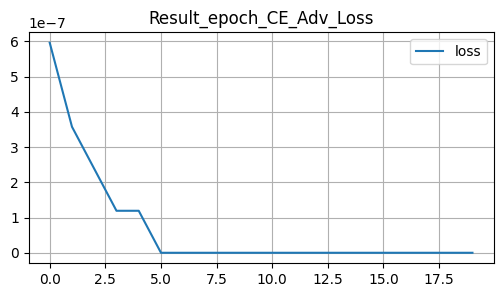

In [110]:
import pandas as pd
import matplotlib.pyplot as plt


result_df = pd.read_csv("/data/ephemeral/home/AD/code/result_file.csv")
pd.set_option('display.max_row', None) ## 모든 행을 출력한다.

x = range(0, len(result_df))
K_list = np.array(x, dtype=int)

# "CE Loss" : result_df["CE Loss"], 
# "AdvLoss" : result_df["AdvLoss"],
perform_score = pd.DataFrame({"loss" :result_df["loss"]}, index=K_list)

print(perform_score)

perform_score.plot(figsize=(6,3), title="Result_epoch_CE_Adv_Loss")
plt.legend(loc='best')
plt.grid()

### 6. Model Inference
- 학습된 IsolationForest, SGDOneClassSVM 모델의 결과를 추론합니다.

### 주의할 점🚨
- 리더보드에서 채점되는 평가 코드는 Label 인 `faultNumber` 에 대해 정상을 `0`, 비정상을 `1` 로 채점합니다.
- 하지만 `IsolationForest` 같은 모델은 기본적으로 정상을 `1`, 비정상을 `-1` 출력합니다. 따라서 해당 모델의 Inference 결과 저장 시 `faultNumber` 인 column에 정상을 `0`, 비정상을 `1` 로 변환해야함을 유의해주시기 바랍니다.
- 아래 `inference` 함수에선 해당 변환 코드를 예시로 이미 추가했습니다.

In [96]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
print(device)

model = LSTM_FC(input_dim=1, num_classes=1, num_hidden_nodes=hd).to(device)
#model = nn.DataParallel(model)

if optim == 1:
    optimizer = optim.SGD(model.parameters(),lr=lr)           
    print("using SGD")
else:
    optimizer = optim.Adam(model.parameters(),lr=lr)
    print("using Adam")
trainer = DROCCTrainer(model, optimizer, lamda, radius, gamma, device)

trainer.model.load_state_dict(torch.load(os.path.join(DATA_PATH, 'Base_DROCCmodel2.pt')))

cuda
using Adam


<All keys matched successfully>

In [97]:
def inference(df):
    label_col = ["faultNumber"]
    return pd.DataFrame(df, columns=label_col)
pred_df = trainer.val(val_loader)

pred_df = inference(pred_df)

- 테스트 데이터를 Load 하여 확인합니다.
- 테스트 데이터는 총 710400 개의 row 와 Label column인 `faultNumber` 가 제외된 54개의 column을 갖고 있습니다.

- 하나의 `simulationRun` 에 대해 학습 데이터가 `500` 개 `sample` 인 반면, 테스트 데이터는 `960` 개의 `sample` 로 이루어져 있습니다.
- 또한, `simulationRun` 번호가 점진적으로 증가하지 않고, 정상/비정상인 `simulationRun` 이 무작위로 섞여있습니다.

- 테스트 데이터에 대해 결과를 추론하여 결과를 확인합니다.
  - `faultNumber` 인 column에 모델 출력 값 정상이 `0`, 비정상이 `1` 이 pandas DataFrame 형태로 저장됐는지 확인합니다.

- 모델 추론 결과의 정상 / 비정상 비율을 확인합니다.

In [98]:
pred_df.describe()

,faultNumber
count,710400.000000
mean,-22.085959
std,0.003794
min,-22.086845
25%,-22.086758
50%,-22.086708
75%,-22.086617
max,-22.051609


In [99]:
thresh = np.percentile(pred_df, 15)
#pred_df = pred_df - 16.6
#thresh = 0.045
y_pred = np.where(pred_df >= thresh, 0, 1)

In [100]:
y_pred = inference(y_pred)

In [101]:
y_pred.value_counts()

faultNumber
0              604021
1              106379
Name: count, dtype: int64

- 리더보드 제출을 위해 결과를 저장합니다.
- `to_csv()` 의 default setting 은 index 까지 보존하는 `index=True` 입니다. 채점하는 evaluation 코드에서도 index가 보존됨을 가정하고 있어 `index=True` 세팅을 지켜주시기 바랍니다.

In [62]:
y_pred.to_csv("output.csv")

In [102]:
_one_index = y_pred[y_pred["faultNumber"] > 0]
_one_index[:50]

,faultNumber
152,1
195,1
196,1
197,1
199,1
200,1
201,1
203,1
204,1
205,1
